# Project description

### We have been tasked to help optimize marketing expenses.

Provided with:
- Server logs with data on Yandex.Afisha visits from June 2017 through May 2018
- Dump file with all orders for the period
- Marketing expenses statistics

Tasked with determining:
- How people use the product
- When they start to buy
- How much money each customer brings
- When they pay off

### Make reports and calculate metrics:
1. Product
- How many people use it every day, week, and month?
- How many sessions are there per day? 
- What is the length of each session?
- What's the user retention rate?

2. Sales
- When do people start buying? 
- How many orders do they make during a given period of time?
- What is the average purchase size?
- How much money do they bring?

3. Marketing
- How much money was spent? Overall, per source and over time.
- How much did customer acquisition from each of the sources cost?
- How worthwhile where the investments?

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import plotly.express as px
import seaborn as sns
import datetime as dt
import plotly.graph_objects as go

In [2]:
# Dowloading first dataset, using dtype and parse_dates parameters to convert 'object' datatypes to correct datatype

visits = pd.read_csv('/datasets/visits_log_us.csv', 
        dtype = {'Device':'category'}, 
        parse_dates = ['End Ts', 'Start Ts'])

In [3]:
visits.info()
display(visits.isnull().sum())
display(visits.duplicated().sum())
display(visits.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 359400 entries, 0 to 359399
Data columns (total 5 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Device     359400 non-null  category      
 1   End Ts     359400 non-null  datetime64[ns]
 2   Source Id  359400 non-null  int64         
 3   Start Ts   359400 non-null  datetime64[ns]
 4   Uid        359400 non-null  uint64        
dtypes: category(1), datetime64[ns](2), int64(1), uint64(1)
memory usage: 11.3 MB


Device       0
End Ts       0
Source Id    0
Start Ts     0
Uid          0
dtype: int64

0

,Device,End Ts,Source Id,Start Ts,Uid
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,16174680259334210214
4,desktop,2017-12-27 14:06:00,3,2017-12-27 14:06:00,9969694820036681168


In [4]:
# Dowloading second dataset, using parse_dates parameter to convert 'object' datatypes to correct datatype

orders = pd.read_csv('/datasets/orders_log_us.csv', parse_dates = ['Buy Ts'])

In [5]:
orders.info()
display(orders.isnull().sum())
display(orders.duplicated().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50415 entries, 0 to 50414
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   Buy Ts   50415 non-null  datetime64[ns]
 1   Revenue  50415 non-null  float64       
 2   Uid      50415 non-null  uint64        
dtypes: datetime64[ns](1), float64(1), uint64(1)
memory usage: 1.2 MB


Buy Ts     0
Revenue    0
Uid        0
dtype: int64

0

In [6]:
# Dowloading third dataset, using parse_dates parameter to convert 'object' datatypes to correct datatype

costs = pd.read_csv('/datasets/costs_us.csv', parse_dates = ['dt'])

In [7]:
costs.info()
display(costs.isnull().sum())
display(costs.duplicated().sum())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2542 entries, 0 to 2541
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   source_id  2542 non-null   int64         
 1   dt         2542 non-null   datetime64[ns]
 2   costs      2542 non-null   float64       
dtypes: datetime64[ns](1), float64(1), int64(1)
memory usage: 59.7 KB


source_id    0
dt           0
costs        0
dtype: int64

0

## 1. How many people use it every day, week, and month?

In [8]:
# Converting 'End Ts' and 'Start Ts' columns to datetime using pd.to_datetime and formatting dates

visits['End Ts'] = pd.to_datetime(
    visits['End Ts'], format="%Y-%m-%d %H:%M")
visits['Start Ts'] = pd.to_datetime(
    visits['Start Ts'], format="%Y-%m-%d %H:%M")

In [9]:
# Calculating weekly and monthly activity, by creating separate columns for year, month, and week values in 'Start Ts' column

visits['session_year'] = visits['Start Ts'].dt.isocalendar().year
visits['session_month'] = visits['Start Ts'].dt.month
visits['session_week'] = visits['Start Ts'].dt.isocalendar().week
visits['session_day'] = visits['Start Ts'].dt.day

visits['Year'] = visits['Start Ts'].astype('datetime64[Y]')
visits['Month'] = visits['Start Ts'].astype('datetime64[M]')
visits['Week'] = visits['Start Ts'].astype('datetime64[W]')
visits['Day'] = visits['Start Ts'].astype('datetime64[D]')

In [10]:
dau = visits.groupby('Day')['Uid'].nunique().reset_index()
wau = visits.groupby(['Year', 'Week'])['Uid'].nunique().reset_index()
mau = visits.groupby(['Year', 'Month'])['Uid'].nunique().reset_index()

In [11]:
dau

,Day,Uid
0,2017-06-01,605
1,2017-06-02,608
2,2017-06-03,445
3,2017-06-04,476
4,2017-06-05,820
...,...,...
359,2018-05-27,620
360,2018-05-28,1039
361,2018-05-29,948
362,2018-05-30,1289


In [12]:
fig = px.line(dau,x="Day", y="Uid", title='DAU')
#adding reference line with average DAU over time
fig.add_hline(y=dau['Uid'].mean(),line_dash="dash", line_color="purple", annotation_text="average DAU",
             annotation_position="top left")
fig.show()

- Average DAU is around 5200 users (Daily Active Users)
- Peak users around 23-24 days with the biggest drop towards the end of the month, days 30-31

In [13]:
fig = px.line(wau,x="Week", y="Uid", title='WAU')
#adding reference line with average WAU over time
fig.add_hline(y=wau['Uid'].mean(),line_dash="dash", line_color="red", annotation_text="average WAU",
             annotation_position="top left")
fig.show()

- Average WAU (Weekly Active Users) around 6,000. 
- Peak WAU towards end of the year, weeks 45-47
- Lowest WAU during middle of the year, during weeks 21-25

In [14]:
fig = px.bar(mau,x="Month", y="Uid", title='MAU')
#adding reference line with average MAU over time
fig.add_hline(y=mau['Uid'].mean(),line_dash="dash", line_color="red", annotation_text="average MAU",
             annotation_position="top left")
fig.show()

- Average MAU (Monthly Active Users) around 24,000
- Peak MAU during end months of the year, which correlates to WAU
- Lowest MAU during the middle of the year, which also correlates to WAU

In [15]:
# Calculating MAU (monthly active users), DAU (daily active users) and WAU (weekly active users)
dau_total = visits.groupby(['Day', 'Year']).agg({'Uid': 'nunique'}).mean()
wau_total = visits.groupby(['Week', 'Year']).agg({'Uid': 'nunique'}).mean()
mau_total = visits.groupby(['Month', 'Year']).agg({'Uid': 'nunique'}).mean()


In [16]:
print("The Daily active users are: ", dau_total)
print("The Weekly active users are: ", wau_total)
print("The Monthly active users are: ", mau_total)

The Daily active users are:  Uid    907.991758
dtype: float64
The Weekly active users are:  Uid    5621.703704
dtype: float64
The Monthly active users are:  Uid    23228.416667
dtype: float64


- The Daily active users are 907.991758
- The Weekly active users are 5621.703704
- The Monthly active users are 23228.416667

## How many sessions are there per day? 

In [17]:
# Calculating the number of sessions per user per day

sessions_per_user = visits.groupby(['Month', 'Year'], as_index=False).agg(
    {'Uid': ['count', 'nunique']})
sessions_per_user.columns = ['Month', 'Year', 'n_sessions', 'n_users']
sessions_per_user['sessions_per_user'] = (sessions_per_user['n_sessions'] / sessions_per_user['n_users'])
print(sessions_per_user)

        Month       Year  n_sessions  n_users  sessions_per_user
0  2017-06-01 2017-01-01       16505    13259           1.244815
1  2017-07-01 2017-01-01       17828    14183           1.256998
2  2017-08-01 2017-01-01       14355    11631           1.234202
3  2017-09-01 2017-01-01       23907    18975           1.259921
4  2017-10-01 2017-01-01       37903    29692           1.276539
5  2017-11-01 2017-01-01       43969    32797           1.340641
6  2017-12-01 2017-01-01       41983    31557           1.330386
7  2018-01-01 2018-01-01       36939    28716           1.286356
8  2018-02-01 2018-01-01       37182    28749           1.293332
9  2018-03-01 2018-01-01       35679    27473           1.298693
10 2018-04-01 2018-01-01       26515    21008           1.262138
11 2018-05-01 2018-01-01       26635    20701           1.286653


- On average, each user spends at most 1 session on the app per day. Low frequency of visits per day

In [18]:
fig = px.bar(sessions_per_user, x = 'Month', y = 'sessions_per_user', title= 'Sessions Per User')
fig.show()

## What is the length of each session?

In [19]:
# Calculating average session length (ASL)

visits['session_duration_sec'] = (visits['End Ts'] - visits['Start Ts']).dt.seconds
print("The average session length is: ", visits['session_duration_sec'].mean()) 
print("The median session length is: ", visits['session_duration_sec'].median())
print("The mode session length is: ", visits['session_duration_sec'].mode())


The average session length is:  643.506488592098
The median session length is:  300.0
The mode session length is:  0    60
dtype: int64


In [20]:
visits['session_duration_sec'] = (visits['End Ts'] - visits['Start Ts'].mean()).dt.seconds
fig = px.histogram(visits['session_duration_sec'], nbins=50)
fig.show()

In [21]:
visits['session_duration_sec'] = (visits['End Ts'] - visits['Start Ts'].median()).dt.seconds
fig = px.histogram(visits['session_duration_sec'], nbins=50)
fig.show()

- Average session length per user is 643.5 seconds, about 11 minutes

## What's the user retention rate?

In [22]:
# Finding the first session for each user
min_visit = visits.groupby(['Uid'])['Start Ts'].min().reset_index()
min_visit.columns = ['Uid', 'first_session']
min_visit.head()

,Uid,first_session
0,11863502262781,2018-03-01 17:27:00
1,49537067089222,2018-02-06 15:55:00
2,297729379853735,2017-06-07 18:47:00
3,313578113262317,2017-09-18 22:49:00
4,325320750514679,2017-09-30 14:29:00


In [23]:
# Merging datasets 'visits' and 'min_visit' 
visits = visits.merge(min_visit, how='inner',on=['Uid'])
visits.head()

,Device,End Ts,Source Id,Start Ts,Uid,session_year,session_month,session_week,session_day,Year,Month,Week,Day,session_duration_sec,first_session
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062,2017,12,51,20,2017-01-01,2017-12-01,2017-12-14,2017-12-20,82320,2017-12-20 17:20:00
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740,2018,2,8,19,2018-01-01,2018-02-01,2018-02-15,2018-02-19,81300,2018-02-19 16:53:00
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527,2017,7,26,1,2017-01-01,2017-07-01,2017-06-29,2017-07-01,25680,2017-07-01 01:54:00
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,16174680259334210214,2018,5,20,20,2018-01-01,2018-05-01,2018-05-17,2018-05-20,59820,2018-03-09 20:05:00
4,desktop,2018-03-09 20:33:00,4,2018-03-09 20:05:00,16174680259334210214,2018,3,10,9,2018-01-01,2018-03-01,2018-03-08,2018-03-09,6420,2018-03-09 20:05:00


In [24]:
# Creating cohort column and age column to begin cohort analysis by month
visits['cohort'] = visits['first_session'].astype('datetime64[M]')
visits['age'] = ((pd.to_datetime(visits['End Ts']) - pd.to_datetime(visits['first_session'])) / np.timedelta64(1,'M'))\
                                                                        .round().astype('int')
visits.head()

,Device,End Ts,Source Id,Start Ts,Uid,session_year,session_month,session_week,session_day,Year,Month,Week,Day,session_duration_sec,first_session,cohort,age
0,touch,2017-12-20 17:38:00,4,2017-12-20 17:20:00,16879256277535980062,2017,12,51,20,2017-01-01,2017-12-01,2017-12-14,2017-12-20,82320,2017-12-20 17:20:00,2017-12-01,0
1,desktop,2018-02-19 17:21:00,2,2018-02-19 16:53:00,104060357244891740,2018,2,8,19,2018-01-01,2018-02-01,2018-02-15,2018-02-19,81300,2018-02-19 16:53:00,2018-02-01,0
2,touch,2017-07-01 01:54:00,5,2017-07-01 01:54:00,7459035603376831527,2017,7,26,1,2017-01-01,2017-07-01,2017-06-29,2017-07-01,25680,2017-07-01 01:54:00,2017-07-01,0
3,desktop,2018-05-20 11:23:00,9,2018-05-20 10:59:00,16174680259334210214,2018,5,20,20,2018-01-01,2018-05-01,2018-05-17,2018-05-20,59820,2018-03-09 20:05:00,2018-03-01,2
4,desktop,2018-03-09 20:33:00,4,2018-03-09 20:05:00,16174680259334210214,2018,3,10,9,2018-01-01,2018-03-01,2018-03-08,2018-03-09,6420,2018-03-09 20:05:00,2018-03-01,0


In [25]:
# Creating pivot table 
cohorts = visits.pivot_table(index='cohort',
                  columns='age',
                  values='Uid',
                  aggfunc='nunique').fillna(0)
cohorts

age,0,1,2,3,4,5,6,7,8,9,10,11,12
cohort,,,,,,,,,,,,,
2017-06-01,13259.0,986.0,710.0,813.0,921.0,880.0,847.0,740.0,743.0,661.0,550.0,526.0,177.0
2017-07-01,13140.0,747.0,679.0,705.0,744.0,639.0,593.0,645.0,489.0,383.0,321.0,71.0,0.0
2017-08-01,10181.0,705.0,629.0,602.0,522.0,427.0,423.0,345.0,297.0,234.0,33.0,0.0,0.0
2017-09-01,16704.0,1278.0,1110.0,826.0,669.0,663.0,554.0,429.0,334.0,43.0,0.0,0.0,0.0
2017-10-01,25977.0,1912.0,1368.0,996.0,949.0,808.0,549.0,464.0,85.0,0.0,0.0,0.0,0.0
2017-11-01,27248.0,1894.0,1260.0,1058.0,861.0,655.0,505.0,73.0,0.0,0.0,0.0,0.0,0.0
2017-12-01,25268.0,1300.0,1034.0,735.0,546.0,409.0,70.0,0.0,0.0,0.0,0.0,0.0,0.0
2018-01-01,22624.0,1220.0,812.0,584.0,389.0,42.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2018-02-01,22197.0,1070.0,589.0,404.0,45.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [26]:
# Calculating retention rate in percentage 
retention=cohorts.iloc[:,0:].div(cohorts[0], axis=0)
retention

age,0,1,2,3,4,5,6,7,8,9,10,11,12
cohort,,,,,,,,,,,,,
2017-06-01,1.0,0.074365,0.053549,0.061317,0.069462,0.066370,0.063881,0.055811,0.056037,0.049853,0.041481,0.039671,0.013349
2017-07-01,1.0,0.056849,0.051674,0.053653,0.056621,0.048630,0.045129,0.049087,0.037215,0.029148,0.024429,0.005403,0.000000
2017-08-01,1.0,0.069247,0.061782,0.059130,0.051272,0.041941,0.041548,0.033887,0.029172,0.022984,0.003241,0.000000,0.000000
2017-09-01,1.0,0.076509,0.066451,0.049449,0.040050,0.039691,0.033166,0.025682,0.019995,0.002574,0.000000,0.000000,0.000000
2017-10-01,1.0,0.073604,0.052662,0.038342,0.036532,0.031104,0.021134,0.017862,0.003272,0.000000,0.000000,0.000000,0.000000
2017-11-01,1.0,0.069510,0.046242,0.038829,0.031599,0.024038,0.018533,0.002679,0.000000,0.000000,0.000000,0.000000,0.000000
2017-12-01,1.0,0.051448,0.040921,0.029088,0.021608,0.016186,0.002770,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2018-01-01,1.0,0.053925,0.035891,0.025813,0.017194,0.001856,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2018-02-01,1.0,0.048205,0.026535,0.018201,0.002027,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


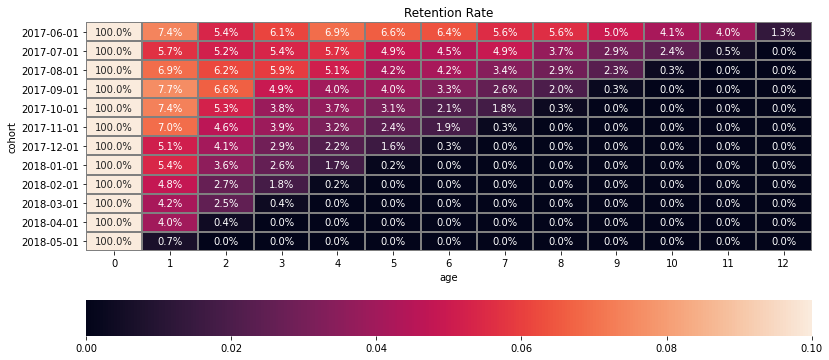

In [27]:
# Visualizing retention rate in heatmap to better understand retention rate by month
retention.index=retention.index.astype(str)
plt.figure(figsize=(13,6))
sns.heatmap(retention, annot=True, fmt='.1%', linewidths=1, linecolor='grey',  vmax=0.1, cbar_kws= {'orientation': 'horizontal'} 
            ).set(title = 'Retention Rate')
plt.show()

- Steady decrease in retention rate month to month

# Sales
## When do people start buying?

In [28]:
first_visit = visits.groupby(['Uid'])['Start Ts'].min().reset_index()
first_visit.columns = ['Uid', 'first_visit']
first_visit.head()

,Uid,first_visit
0,11863502262781,2018-03-01 17:27:00
1,49537067089222,2018-02-06 15:55:00
2,297729379853735,2017-06-07 18:47:00
3,313578113262317,2017-09-18 22:49:00
4,325320750514679,2017-09-30 14:29:00


In [29]:
first_order=orders.groupby(['Uid'])['Buy Ts'].min().reset_index()
first_order.columns = ['Uid', 'first_order']
first_order.head()

,Uid,first_order
0,313578113262317,2018-01-03 21:51:00
1,1575281904278712,2017-06-03 10:13:00
2,2429014661409475,2017-10-11 18:33:00
3,2464366381792757,2018-01-28 15:54:00
4,2551852515556206,2017-11-24 10:14:00


In [30]:
purchase =first_visit.merge(first_order, how='left',on=['Uid'])
purchase = purchase.dropna()
purchase.head()

,Uid,first_visit,first_order
3,313578113262317,2017-09-18 22:49:00,2018-01-03 21:51:00
22,1575281904278712,2017-06-03 10:13:00,2017-06-03 10:13:00
35,2429014661409475,2017-10-11 17:14:00,2017-10-11 18:33:00
36,2464366381792757,2018-01-27 20:10:00,2018-01-28 15:54:00
38,2551852515556206,2017-11-24 10:14:00,2017-11-24 10:14:00


In [31]:
purchase['conversion']=((pd.to_datetime(purchase['first_order'])-pd.to_datetime(purchase['first_visit']))/np.timedelta64(1,'D')).astype('int')
display(purchase['conversion'].mean())


16.7298688497659

(array([33388.,  1715.,   896.,   399.,   125.]),
 array([  0. ,  72.6, 145.2, 217.8, 290.4, 363. ]),
 <BarContainer object of 5 artists>)

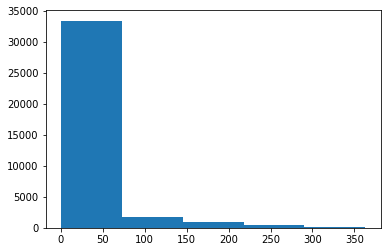

In [32]:
purchase['conversion']=((pd.to_datetime(purchase['first_order'])-pd.to_datetime(purchase['first_visit']))/np.timedelta64(1,'D').mean()).astype('int')
plt.hist(purchase['conversion'], bins=5)


- Most users buy between the first 20 days of their first session. 

In [33]:
purchase['conversion'].mean()

16.7298688497659

In [34]:
print(' The overall conversion is {:.1%}'.format(purchase['Uid'].nunique()/visits['Uid'].nunique()))

 The overall conversion is 16.0%


In [35]:
# Defining cohort month through first purchase
orders=orders.merge(purchase, how='left', on='Uid')
orders['first_order_month']=orders['first_order'].astype('datetime64[M]')
orders['month'] = orders['Buy Ts'].astype('datetime64[M]')
orders.head()

,Buy Ts,Revenue,Uid,first_visit,first_order,conversion,first_order_month,month
0,2017-06-01 00:10:00,17.00,10329302124590727494,2017-06-01 00:09:00,2017-06-01 00:10:00,0,2017-06-01,2017-06-01
1,2017-06-01 00:25:00,0.55,11627257723692907447,2017-06-01 00:14:00,2017-06-01 00:25:00,0,2017-06-01,2017-06-01
2,2017-06-01 00:27:00,0.37,17903680561304213844,2017-06-01 00:25:00,2017-06-01 00:27:00,0,2017-06-01,2017-06-01
3,2017-06-01 00:29:00,0.55,16109239769442553005,2017-06-01 00:14:00,2017-06-01 00:29:00,0,2017-06-01,2017-06-01
4,2017-06-01 07:58:00,0.37,14200605875248379450,2017-06-01 07:31:00,2017-06-01 07:58:00,0,2017-06-01,2017-06-01


In [36]:
# Defining cohort size. 
# Using the month of first purchase we will define which cohort our buyers belongs to
cohort_sizes = orders.groupby('first_order_month').agg({'Uid': 'nunique'}).reset_index()
cohort_sizes.columns=['first_order_month','cohort_size']
cohort_sizes.head()

,first_order_month,cohort_size
0,2017-06-01,2023
1,2017-07-01,1923
2,2017-08-01,1370
3,2017-09-01,2581
4,2017-10-01,4340


In [37]:
# Calculating number of purchases for cohort and month
cohort=orders.groupby(['first_order_month','month'])['Revenue'].count().reset_index()
cohort.columns=['first_order_month','month','orders']

# Merge cohort with cohort size
cohort=cohort.merge(cohort_sizes,on=['first_order_month'])
cohort['age_month'] = ((cohort['month'] - cohort['first_order_month']) / np.timedelta64(1,'M')).round()
cohort['orders_per_buyer']=cohort['orders']/cohort['cohort_size']
cohort.head()

,first_order_month,month,orders,cohort_size,age_month,orders_per_buyer
0,2017-06-01,2017-06-01,2354,2023,0.0,1.163618
1,2017-06-01,2017-07-01,177,2023,1.0,0.087494
2,2017-06-01,2017-08-01,174,2023,2.0,0.086011
3,2017-06-01,2017-09-01,226,2023,3.0,0.111715
4,2017-06-01,2017-10-01,292,2023,4.0,0.144340


In [38]:
cohort_piv=cohort.pivot_table(
    index='first_order_month', 
    columns='age_month', 
    values='orders_per_buyer', 
    aggfunc='sum'
).cumsum(axis=1)

cohort_piv.round(2).fillna('')

age_month,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0
first_order_month,,,,,,,,,,,,
2017-06-01,1.16,1.25,1.34,1.45,1.59,1.7,1.84,1.92,2.03,2.1,2.15,2.19
2017-07-01,1.14,1.19,1.25,1.31,1.34,1.39,1.42,1.44,1.47,1.49,1.51,
2017-08-01,1.12,1.2,1.27,1.33,1.39,1.44,1.47,1.53,1.56,1.6,,
2017-09-01,1.14,1.22,1.28,1.35,1.37,1.42,1.46,1.48,1.5,,,
2017-10-01,1.14,1.22,1.25,1.28,1.31,1.34,1.35,1.38,,,,
2017-11-01,1.18,1.28,1.32,1.37,1.41,1.42,1.45,,,,,
2017-12-01,1.15,1.21,1.26,1.3,1.32,1.34,,,,,,
2018-01-01,1.12,1.19,1.24,1.25,1.28,,,,,,,
2018-02-01,1.12,1.18,1.21,1.22,,,,,,,,


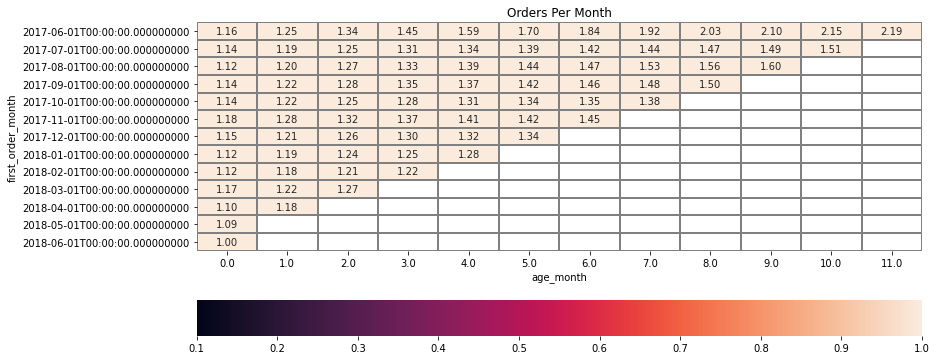

In [39]:
plt.figure(figsize=(13,6))
sns.heatmap(cohort_piv, annot=True, fmt='.2f', linewidths=1, linecolor='grey',  vmax=0.1, cbar_kws= {'orientation': 'horizontal'} 
            ).set(title = 'Orders Per Month')
plt.show()

- First cohort has a steady increase in orders per month
- Other cohorts have a slight increase in orders per month, much lower than first cohort.  

## What is the average purchase size?

In [40]:
avg_purchase_size = orders.groupby(['month'])['Revenue'].mean().reset_index()
fig = px.line(avg_purchase_size, x = 'month', y = 'Revenue', title = 'Average Purchase Size')
fig.show()

print('Total average purchase size is {}'.format(avg_purchase_size['Revenue'].mean()))

Total average purchase size is 4.838699619166338


## How much money do they bring? (LTV)

In [41]:
# Revenue per cohort in each month
ltv_cohort=orders.groupby(['first_order_month','month'])['Revenue'].sum().reset_index()
ltv_cohort.columns = ['first_order_month','month','revenue']

#merge with the cohort size
ltv_cohort=ltv_cohort.merge(cohort_sizes,on=['first_order_month'])
ltv_cohort['age']=((ltv_cohort['month'] - ltv_cohort['first_order_month']) / np.timedelta64(1,'M')).round()
ltv_cohort['ltv']=ltv_cohort['revenue']/ltv_cohort['cohort_size']
ltv_cohort

,first_order_month,month,revenue,cohort_size,age,ltv
0,2017-06-01,2017-06-01,9557.49,2023,0.0,4.724414
1,2017-06-01,2017-07-01,981.82,2023,1.0,0.485329
2,2017-06-01,2017-08-01,885.34,2023,2.0,0.437637
3,2017-06-01,2017-09-01,1931.30,2023,3.0,0.954671
4,2017-06-01,2017-10-01,2068.58,2023,4.0,1.022531
...,...,...,...,...,...,...
74,2018-03-01,2018-05-01,1114.87,3533,2.0,0.315559
75,2018-04-01,2018-04-01,10600.69,2276,0.0,4.657597
76,2018-04-01,2018-05-01,1209.92,2276,1.0,0.531599
77,2018-05-01,2018-05-01,13925.76,2988,0.0,4.660562


In [42]:
ltv_cohort_piv=ltv_cohort.pivot_table(
    index='first_order_month', 
    columns='age', 
    values='ltv', 
    aggfunc='sum'
).cumsum(axis=1)


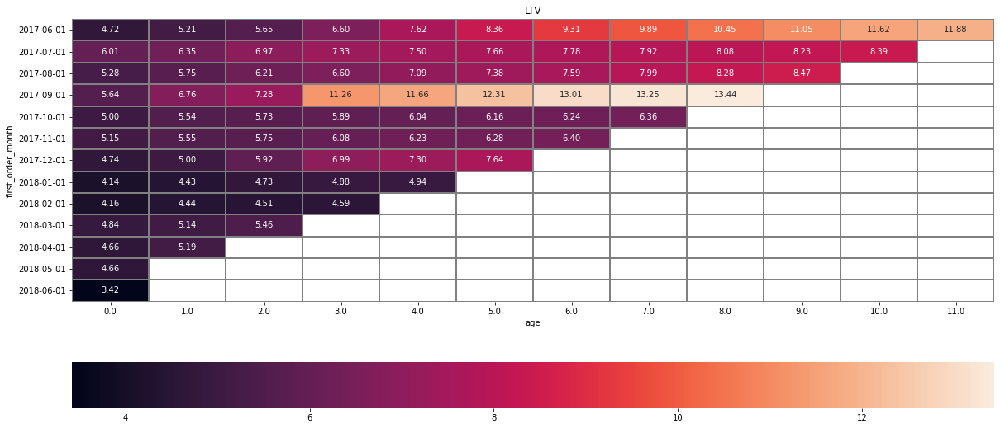

In [43]:
ltv_cohort_piv.index=ltv_cohort_piv.index.astype(str)
plt.figure(figsize=(20,9))
sns.heatmap(ltv_cohort_piv, annot=True, fmt='.2f', linewidths=1, linecolor='grey', cbar_kws= {'orientation': 'horizontal'} 
            ).set(title ='LTV')
plt.show()

In [44]:
print('Total amount of money customers bring in {}'.format(ltv_cohort['revenue'].sum()))

Total amount of money customers bring in 252057.19999999934


In [45]:
avg_cohort_sizes = orders.groupby('first_order_month').agg({'Uid': 'nunique'}).reset_index()
avg_cohort_sizes.columns=['first_order_month','buyers']
avg_cohort_sizes.head()

,first_order_month,buyers
0,2017-06-01,2023
1,2017-07-01,1923
2,2017-08-01,1370
3,2017-09-01,2581
4,2017-10-01,4340


In [46]:
avg_cohort=orders.groupby(['first_order_month','month'])['Revenue'].sum().reset_index()
avg_cohort['age_month'] = ((avg_cohort['month'] - avg_cohort['first_order_month']) / np.timedelta64(1,'M')).round()
avg_cohort.head()

,first_order_month,month,Revenue,age_month
0,2017-06-01,2017-06-01,9557.49,0.0
1,2017-06-01,2017-07-01,981.82,1.0
2,2017-06-01,2017-08-01,885.34,2.0
3,2017-06-01,2017-09-01,1931.30,3.0
4,2017-06-01,2017-10-01,2068.58,4.0


In [47]:
ltv_cohort = avg_cohort_sizes.merge(avg_cohort,on=['first_order_month'])
ltv_cohort['age_month'] = ((ltv_cohort['month'] - ltv_cohort['first_order_month']) / np.timedelta64(1,'M')).round()
ltv_cohort['ltv']=ltv_cohort['Revenue']/ltv_cohort['buyers']
ltv_cohort.head()

,first_order_month,buyers,month,Revenue,age_month,ltv
0,2017-06-01,2023,2017-06-01,9557.49,0.0,4.724414
1,2017-06-01,2023,2017-07-01,981.82,1.0,0.485329
2,2017-06-01,2023,2017-08-01,885.34,2.0,0.437637
3,2017-06-01,2023,2017-09-01,1931.30,3.0,0.954671
4,2017-06-01,2023,2017-10-01,2068.58,4.0,1.022531


In [48]:
ltv_cohort_pivot=ltv_cohort.pivot_table(
    index='first_order_month', 
    columns='age_month', 
    values='ltv', 
    aggfunc='sum'
).cumsum(axis=1)
ltv_cohort_pivot.round(2).fillna('')

age_month,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0
first_order_month,,,,,,,,,,,,
2017-06-01,4.72,5.21,5.65,6.6,7.62,8.36,9.31,9.89,10.45,11.05,11.62,11.88
2017-07-01,6.01,6.35,6.97,7.33,7.5,7.66,7.78,7.92,8.08,8.23,8.39,
2017-08-01,5.28,5.75,6.21,6.6,7.09,7.38,7.59,7.99,8.28,8.47,,
2017-09-01,5.64,6.76,7.28,11.26,11.66,12.31,13.01,13.25,13.44,,,
2017-10-01,5.00,5.54,5.73,5.89,6.04,6.16,6.24,6.36,,,,
2017-11-01,5.15,5.55,5.75,6.08,6.23,6.28,6.4,,,,,
2017-12-01,4.74,5.0,5.92,6.99,7.3,7.64,,,,,,
2018-01-01,4.14,4.43,4.73,4.88,4.94,,,,,,,
2018-02-01,4.16,4.44,4.51,4.59,,,,,,,,


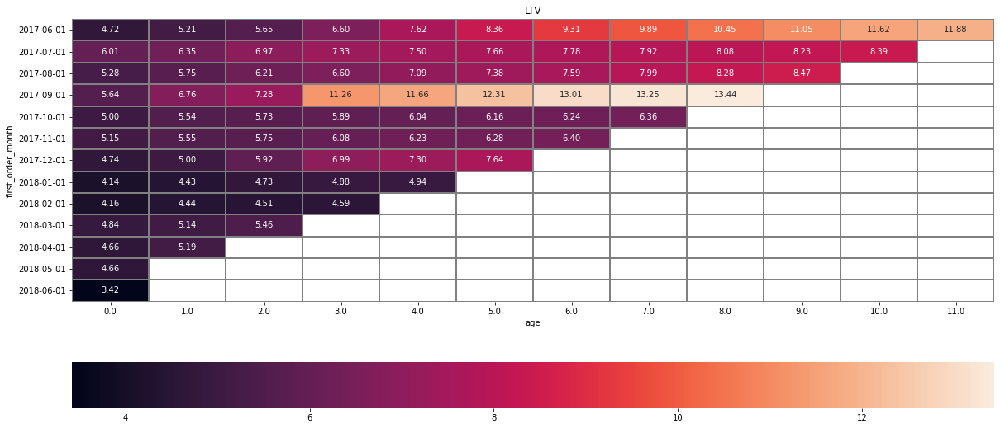

In [49]:
ltv_cohort_pivot.index=ltv_cohort_pivot.index.astype(str)
plt.figure(figsize=(20,9))
sns.heatmap(ltv_cohort_piv, annot=True, fmt='.2f', linewidths=1, linecolor='grey', cbar_kws= {'orientation': 'horizontal'} 
            ).set(title ='LTV')
plt.show()


## How much money was spent?

In [50]:
costs=costs.sort_values(by=['dt','source_id'])
costs.head()

,source_id,dt,costs
0,1,2017-06-01,75.20
363,2,2017-06-01,132.56
726,3,2017-06-01,349.38
1089,4,2017-06-01,76.74
1452,5,2017-06-01,73.24


In [51]:
print('Total marketing cost is {}'.format(costs['costs'].sum()))

Total marketing cost is 329131.62


## How much did customer acquisition from each of the sources cost?

In [52]:
marketing_per_source=costs.groupby(['source_id'])['costs'].sum().reset_index()
marketing_per_source

,source_id,costs
0,1,20833.27
1,2,42806.04
2,3,141321.63
3,4,61073.60
4,5,51757.10
5,9,5517.49
6,10,5822.49


- Source 3 has the highest cost
- Source 9 has the lowest cost
    - source id:1, costs: 20833.27
    - source id:2, costs: 42806.04
    - source id:3, costs: 141321.63
    - source id:4, costs: 61073.60
    - source id:5, costs: 51757.10
    - source id:9, costs: 5517.49
    - source id:10, costs: 5822.49

In [53]:
# Visual representation of customer cost per source
fig = px.line(costs, x="dt", y="costs", color='source_id')
fig.show()

- Total amount of money customers bring in 6962207.35
- Total marketing cost is 329131.62

The company is bringing in more money than what is being spent on bringing in more customers, signs of a healthy business. 

In [54]:
costs['month'] = costs['dt'].astype('datetime64[M]')
costs_month = costs.groupby('month')['costs'].sum().reset_index()
costs_month.head()
fig = px.line(costs_month, x = 'month', y='costs', title = "Total Costs per Month")
fig.show()

In [55]:
marketing_per_source_v1=costs.groupby(['source_id', 'month'])['costs'].sum().reset_index()
fig = px.line(marketing_per_source_v1, x = 'month', y = 'costs', color = 'source_id', title = "Monthly Costs per Source")
fig.show()

## How much did customer acquisition from each of the sources cost?

In [56]:
# Renaming columns to merge with orders dataset
marketing_per_source = marketing_per_source.rename(columns={'source_id': 'Source Id'})
marketing_per_source.head()

,Source Id,costs
0,1,20833.27
1,2,42806.04
2,3,141321.63
3,4,61073.60
4,5,51757.10


In [57]:
marketing_by_month=costs.groupby(['month'])['costs'].sum().reset_index()
marketing_by_month.columns=['cost_month','marketing_cost']
marketing_by_month.head()

,cost_month,marketing_cost
0,2017-06-01,18015.00
1,2017-07-01,18240.59
2,2017-08-01,14790.54
3,2017-09-01,24368.91
4,2017-10-01,36322.88


In [58]:
buyers_per_month=orders.groupby(['first_order_month'])['Uid'].nunique().reset_index()
buyers_per_month.columns=['cost_month','buyers']
buyers_per_month.head()

,cost_month,buyers
0,2017-06-01,2023
1,2017-07-01,1923
2,2017-08-01,1370
3,2017-09-01,2581
4,2017-10-01,4340


In [59]:
CAC_per_month=marketing_by_month.merge(buyers_per_month,how='left',on=['cost_month'])
CAC_per_month['CAC']=CAC_per_month['marketing_cost']/CAC_per_month['buyers']
CAC_per_month.head()

,cost_month,marketing_cost,buyers,CAC
0,2017-06-01,18015.00,2023,8.905091
1,2017-07-01,18240.59,1923,9.485486
2,2017-08-01,14790.54,1370,10.796015
3,2017-09-01,24368.91,2581,9.441654
4,2017-10-01,36322.88,4340,8.369327


In [60]:
fig = px.line(CAC_per_month, x='cost_month', y='CAC', title = 'CAC per Month')
fig.show()

- CAC per month: 
    - Peak CAC during July, with a strong dip during September and October
    - The rest of the year fluctuated with rises and falls, with the lowest CAC being in May 2018. 

In [61]:
first_source=visits.sort_values('Start Ts').groupby('Uid').first()['Source Id'].reset_index()
first_source.columns=['Uid','first_source']
first_source.head()

,Uid,first_source
0,11863502262781,3
1,49537067089222,2
2,297729379853735,3
3,313578113262317,2
4,325320750514679,5


In [62]:
orders=orders.merge(first_source,on=['Uid'],how='left')
orders.head()

,Buy Ts,Revenue,Uid,first_visit,first_order,conversion,first_order_month,month,first_source
0,2017-06-01 00:10:00,17.00,10329302124590727494,2017-06-01 00:09:00,2017-06-01 00:10:00,0,2017-06-01,2017-06-01,1
1,2017-06-01 00:25:00,0.55,11627257723692907447,2017-06-01 00:14:00,2017-06-01 00:25:00,0,2017-06-01,2017-06-01,2
2,2017-06-01 00:27:00,0.37,17903680561304213844,2017-06-01 00:25:00,2017-06-01 00:27:00,0,2017-06-01,2017-06-01,2
3,2017-06-01 00:29:00,0.55,16109239769442553005,2017-06-01 00:14:00,2017-06-01 00:29:00,0,2017-06-01,2017-06-01,2
4,2017-06-01 07:58:00,0.37,14200605875248379450,2017-06-01 07:31:00,2017-06-01 07:58:00,0,2017-06-01,2017-06-01,3


In [63]:

marketing_by_month_source=costs.groupby(['month','source_id'])['costs'].mean().reset_index()
marketing_by_month_source.columns=['cost_month','source', 'marketing_cost']
marketing_by_month_source.head()


,cost_month,source,marketing_cost
0,2017-06-01,1,37.520333
1,2017-06-01,2,80.912667
2,2017-06-01,3,257.721667
3,2017-06-01,4,117.160000
4,2017-06-01,5,87.204000


In [64]:
buyers_per_month_source=orders.groupby(['first_order_month','first_source'])['Uid'].nunique().reset_index()
buyers_per_month_source.columns=['cost_month','source','buyers']
buyers_per_month_source.head()

,cost_month,source,buyers
0,2017-06-01,1,190
1,2017-06-01,2,235
2,2017-06-01,3,638
3,2017-06-01,4,413
4,2017-06-01,5,384


In [65]:
CAC_per_month_source=marketing_by_month_source.merge(buyers_per_month_source,how='left',on=['cost_month','source'])
CAC_per_month_source['CAC']=CAC_per_month_source['marketing_cost']/CAC_per_month_source['buyers']
CAC_per_month_source.head()

,cost_month,source,marketing_cost,buyers,CAC
0,2017-06-01,1,37.520333,190,0.197475
1,2017-06-01,2,80.912667,235,0.344309
2,2017-06-01,3,257.721667,638,0.403952
3,2017-06-01,4,117.160000,413,0.283680
4,2017-06-01,5,87.204000,384,0.227094


In [66]:
fig = px.line(CAC_per_month_source, x="cost_month", y="CAC",color='source',title='CAC per Source')
fig.show()

- CAC per source: 
    - Source 2 and 3 have the highest CAC, with source 2 having a significant dip towards May 2018
    - Source 9, 10 and 4 have lowest CAC of the rest of the sources
        - Source 10 overall has lowest CAC per month

<div class="alert alert-block alert-danger">
<s><b>Reviewer's comment</b> <a class="tocSkip"></a>
    
Use costs for calculate mean cac. After we need:
    
- group costs by month and sum costs
- group orders by first order month using nunique uid
- merge(indexes are true)
- calculate cac
- plot a graph by month
    
For CAC per source we need;
    
- find first source per user in visits
- find  first order month and first order day in orders
- merge tables
- group new table by source id and first order day  and count uid
- merge with costs (left using source id and first order day and  right using source id and costs day. )
- calculate cac per source
- plot a graph by month per source

</div>

## How worthwhile where the investments? (ROI)

In [67]:

orders = orders.merge(costs, how='left', on = 'month')
orders.head()

,Buy Ts,Revenue,Uid,first_visit,first_order,conversion,first_order_month,month,first_source,source_id,dt,costs
0,2017-06-01 00:10:00,17.0,10329302124590727494,2017-06-01 00:09:00,2017-06-01 00:10:00,0,2017-06-01,2017-06-01,1,1.0,2017-06-01,75.20
1,2017-06-01 00:10:00,17.0,10329302124590727494,2017-06-01 00:09:00,2017-06-01 00:10:00,0,2017-06-01,2017-06-01,1,2.0,2017-06-01,132.56
2,2017-06-01 00:10:00,17.0,10329302124590727494,2017-06-01 00:09:00,2017-06-01 00:10:00,0,2017-06-01,2017-06-01,1,3.0,2017-06-01,349.38
3,2017-06-01 00:10:00,17.0,10329302124590727494,2017-06-01 00:09:00,2017-06-01 00:10:00,0,2017-06-01,2017-06-01,1,4.0,2017-06-01,76.74
4,2017-06-01 00:10:00,17.0,10329302124590727494,2017-06-01 00:09:00,2017-06-01 00:10:00,0,2017-06-01,2017-06-01,1,5.0,2017-06-01,73.24


In [68]:
CAC_per_month_ROI=CAC_per_month[['cost_month','CAC']]
CAC_per_month_ROI.columns=['first_order_month','CAC']
ROI=ltv_cohort.merge(CAC_per_month_ROI,on=['first_order_month'],how='left')
ROI.head()

,first_order_month,buyers,month,Revenue,age_month,ltv,CAC
0,2017-06-01,2023,2017-06-01,9557.49,0.0,4.724414,8.905091
1,2017-06-01,2023,2017-07-01,981.82,1.0,0.485329,8.905091
2,2017-06-01,2023,2017-08-01,885.34,2.0,0.437637,8.905091
3,2017-06-01,2023,2017-09-01,1931.30,3.0,0.954671,8.905091
4,2017-06-01,2023,2017-10-01,2068.58,4.0,1.022531,8.905091


In [69]:
ROI['ROI']=ROI['ltv']/ROI['CAC']
roi_piv = ROI.pivot_table(
    index='first_order_month', columns='age_month', values='ROI', aggfunc='mean'
).cumsum(axis=1).round(2) 

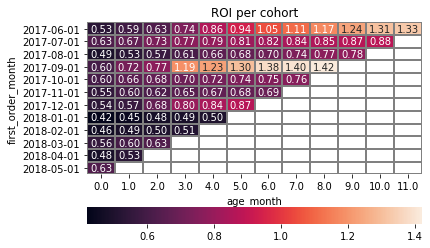

In [70]:
roi_piv.index=roi_piv.index.astype(str)
sns.heatmap(roi_piv, annot=True, fmt='.2f', linewidths=1, linecolor='grey', cbar_kws= {'orientation': 'horizontal'} 
            ).set(title ='ROI per cohort')
plt.show()

In [71]:
ltv_per_source=orders.groupby(['first_source'])['Uid','costs'].agg({'Uid':'nunique','costs':'sum'}).reset_index()
ltv_per_source.columns=['source','buyers','revenue']
ltv_per_source['ltv']=ltv_per_source['revenue']/ltv_per_source['buyers']
ltv_per_source

/tmp/ipykernel_59/1791774378.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,source,buyers,revenue,ltv
0,1,2899,1.551358e+08,53513.540017
1,2,3506,1.904066e+08,54308.783240
2,3,10473,4.004321e+08,38234.704692
3,4,10296,3.941237e+08,38279.299843
4,5,6931,2.806254e+08,40488.437119
5,7,1,1.479054e+04,14790.540000
6,9,1088,4.971496e+07,45693.899026
7,10,1329,4.594661e+07,34572.319842


In [72]:
roi_per_source=marketing_by_month_source.merge(ltv_per_source,on=['source'])
roi_per_source['cac']=roi_per_source['marketing_cost']/roi_per_source['buyers']
roi_per_source['romi']=roi_per_source['ltv']/roi_per_source['cac']
roi_per_source

,cost_month,source,marketing_cost,buyers,revenue,ltv,cac,romi
0,2017-06-01,1,37.520333,2899,1.551358e+08,53513.540017,0.012943,4.134711e+06
1,2017-07-01,1,34.609032,2899,1.551358e+08,53513.540017,0.011938,4.482522e+06
2,2017-08-01,1,30.703548,2899,1.551358e+08,53513.540017,0.010591,5.052698e+06
3,2017-09-01,1,50.067000,2899,1.551358e+08,53513.540017,0.017270,3.098563e+06
4,2017-10-01,1,74.701613,2899,1.551358e+08,53513.540017,0.025768,2.076739e+06
...,...,...,...,...,...,...,...,...
79,2018-01-01,10,19.817742,1329,4.594661e+07,34572.319842,0.014912,2.318459e+06
80,2018-02-01,10,17.174286,1329,4.594661e+07,34572.319842,0.012923,2.675314e+06
81,2018-03-01,10,17.547000,1329,4.594661e+07,34572.319842,0.013203,2.618488e+06
82,2018-04-01,10,13.387931,1329,4.594661e+07,34572.319842,0.010074,3.431943e+06


In [73]:
fig = px.bar(roi_per_source, x='source', y='romi')
fig.update_xaxes(type='category')
fig.show()

# Conclusions 

1. Product

In regards to the product, we first had to determine how many users used the platform. Divided users by daily users, weekly users and monthly users. 
   - The Daily active users are 907.991758
   - The Weekly active users are 5621.703704
   - The Monthly active users are 23228
    
After finding the amount of users, calculated the average time users spend on the platform per day. We found that on average, each user spends at most 1 session on the platform per day. Low frequency of visits per day

Next, we calculated how much time user would spend on average on the platform. Calculated the average session length per user to be 643.5 seconds, about 11 minutes

In regards to the retention rate, we have a steady decrease in retention rate month to month, starting at about 7% and going all the way down to 4%. Not an ideal retention rate for users. 

2. Sales

Users on average order in the first 20 days of their first session, giving us a 16% conversion rate, again not an ideal conversion rate.  

Next we looked for how many orders per month were made by buyers. In the first cohort, we have a steady increase in orders per month, going from 1.16 to about 2 orders per month towards the end of the year. The other cohorts have a slight increase in orders per month, but much lower than first cohort, with none of the them reaching 2 orders per month. 

We then calculated the total average purchase size, which came out to be 4.8 items per order. 

In total, the amount of money customers bring in is $6962207.35

3. Marketing

In regards to money spent in orders to bring in customers, we calculated per source and over time. In total, marketing cost is $329131.62, which is less the the amount of money that customers bring in, which is a sign of a healthy business. 

Divided by source, we calculated the following: 
   - Source 3 has the highest cost
   - Source 9 has the lowest cost
   - Source 1, Cost: 20833.27
   - Source 2, Cost: 42806.04
   - Source 3, Cost: 141321.63
   - Source 4, Cost: 61073.60
   - Source 5, Cost: 51757.10
   - Source 9, Cost: 5517.49
   - Source 10, Cost: 5822.49

We proceeded to calculate the customer acquisition cost per month and per source:

   - CAC per month:
        - Peak CAC during July, with a strong dip during September and October
        - The rest of the year fluctuated with rises and falls, with the lowest CAC being in May 2018.
   - CAC per source: 
        - Source 2 and 3 have the highest CAC, with source 2 having a significant dip towards May 2018
        - Source 9, 10 and 4 have lowest CAC of the rest of the sources
            - Source 10 overall has lowest CAC per month
            
Finally, Source 1, 9 and 10 have the highest Return of Marketing Investment (ROMI), no necessary changes for these sources and they are the highest earners. Source 3 has the lowest ROMI, eliminating this source would be worthwhile as the ROMI indicates that marketing revenue is not as high as other sources.